## Import thư viện

In [2]:
import numpy as np
import gymnasium as gym
import torch
import torch.nn as nn
import torch.optim as optim
from collections import deque
import imageio
import random
import matplotlib.pyplot as plt
from torch.distributions import Categorical
from matplotlib import animation
from IPython.display import HTML

# 1. DQN

## Định nghĩa mạng nơ-ron cho DQN

In [2]:
# Định nghĩa Mạng Nơ-ron DQN
class DQN(nn.Module):
    def __init__(self, state_size, action_size):
        super(DQN, self).__init__()
        self.fc1 = nn.Linear(state_size, 128)
        self.fc2 = nn.Linear(128, 128)
        self.fc3 = nn.Linear(128, action_size)

    def forward(self, state):
        x = torch.relu(self.fc1(state))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return x

## Khởi tạo Agent

In [ ]:
# Agent DQN - Khởi tạo và thiết lập bằng config dictionary
class DQNAgent:
    def __init__(self, config):
        self.config = config
        self.env = gym.make(config.get("env_name", "LunarLander-v3"))
        self.state_size = self.env.observation_space.shape[0]
        self.action_size = self.env.action_space.n

        # Tham số DQN từ config
        self.alpha = config.get("learning_rate", 0.001)
        self.gamma = config.get("gamma", 0.99)
        self.epsilon = config.get("epsilon", 1.0)
        self.epsilon_min = config.get("epsilon_min", 0.01)
        self.epsilon_decay = config.get("epsilon_decay", 0.995)
        self.n_episodes = config.get("n_episodes", 2000)
        self.batch_size = config.get("batch_size", 64)

        # Hàm shaping thưởng
        self.reward_shaping_fn = config.get("reward_shaping_fn", lambda s, a, r, ns, d: r)

        # Bộ nhớ kinh nghiệm
        self.buffer_size = config.get("buffer_size", 100000)
        self.memory = deque(maxlen=self.buffer_size)


        # Mạng chính và mạng mục tiêu
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

        self.model = DQN(self.state_size, self.action_size).to(self.device)
        self.target_model = DQN(self.state_size, self.action_size).to(self.device)


        self.optimizer = optim.Adam(self.model.parameters(), lr=self.alpha)

        self.update_target_network()
        self.reward_per_episode = []
    # Cập nhật trọng số cho mạng mục tiêu từ mạng chính
    def update_target_network(self):
        self.target_model.load_state_dict(self.model.state_dict())

    # Chọn hành động dựa trên chính sách epsilon-greedy
    def choose_action(self, state):
        if np.random.rand() < self.epsilon:
            return self.env.action_space.sample()
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            q_values = self.model(state_tensor)
        return torch.argmax(q_values).item()

    # Ghi nhớ kinh nghiệm để huấn luyện sau này
    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))


## Replay memory 

In [4]:
# Hàm lưu kinh nghiệm 
def replay_dqn(agent):
    """Huấn luyện mạng Q của agent bằng experience replay."""
    if len(agent.memory) < agent.batch_size:
        return

    batch = random.sample(agent.memory, agent.batch_size)
    states, actions, rewards, next_states, dones = zip(*batch)

    states = torch.FloatTensor(states).to(agent.device)
    next_states = torch.FloatTensor(next_states).to(agent.device)
    actions = torch.LongTensor(actions).to(agent.device)
    rewards = torch.FloatTensor(rewards).to(agent.device)
    dones = torch.FloatTensor(dones).to(agent.device)


    # Q-values hiện tại từ mạng chính
    q_values = agent.model(states).gather(1, actions.unsqueeze(1)).squeeze(1)

    # Q-values mục tiêu từ target network
    next_q_values = agent.target_model(next_states).max(1)[0]
    target_q_values = rewards + agent.gamma * next_q_values * (1 - dones)

    # Tính loss và cập nhật
    loss = nn.MSELoss()(q_values, target_q_values)
    agent.optimizer.zero_grad()
    loss.backward()
    agent.optimizer.step()


## Huấn luyện 

In [5]:
# Hàm train 
def train_dqn(agent):
    for episode in range(agent.n_episodes):
        state, _ = agent.env.reset()
        total_reward = 0
        done = False

        while not done:
            # Chọn hành động
            action = agent.choose_action(state)

            # Bước tương tác với môi trường
            next_state, reward, terminated, truncated, _ = agent.env.step(action)
            done = terminated or truncated

            # Reward shaping (tùy phiên bản)
            shaped_reward = agent.reward_shaping_fn(state, action, reward, next_state, done)

            # Lưu và huấn luyện
            agent.remember(state, action, shaped_reward, next_state, done)
            replay_dqn(agent)

            state = next_state
            total_reward += shaped_reward

        # Cập nhật epsilon
        agent.epsilon = max(agent.epsilon_min, agent.epsilon * agent.epsilon_decay)
        agent.reward_per_episode.append(total_reward)

        print(f"[{type(agent).__name__}] Episode {episode + 1}/{agent.n_episodes} | "
              f"Reward: {total_reward:.2f} | Epsilon: {agent.epsilon:.4f}")

        if episode % 10 == 0:
            agent.update_target_network()

    agent.env.close()


## Vẽ biểu đồ kết quả

In [6]:
# Vẽ biểu đồ phần thưởng qua mỗi tập
def plot_rewards(agent):
    plt.figure(figsize=(20,10))
    plt.plot(agent.reward_per_episode)
    plt.xlabel("Episode")
    plt.ylabel("Total Reward")
    plt.title("DQN on LunarLander")
    plt.grid()
    plt.show()


## Ghi lại video mô phỏng 

In [7]:
# Ghi lại video mô phỏng tác nhân đã học
def record_video(agent, filename):
    env = gym.make("LunarLander-v3", render_mode="rgb_array")
    state, _ = env.reset()
    frames = []

    done = False
    while not done:
        frame = env.render()
        frames.append(frame)
        action = agent.choose_action(state)
        state, _, terminated, truncated, _ = env.step(action)
        done = terminated or truncated

    env.close()
    imageio.mimsave(filename, [np.array(f) for f in frames], fps=30)

## Đánh giá mô hình 

In [ ]:
# Hàm đánh giá mô hình trên 20 tập 
def evaluate_agent(agent, model_path, env_name="LunarLander-v3", n_episodes=20):
    from matplotlib import animation
    from IPython.display import HTML

    # Load model
    agent.model.load_state_dict(torch.load(model_path))
    agent.model.eval()
    
    # Tạm thời tắt exploration
    original_epsilon = agent.epsilon
    agent.epsilon = 0.0

    env = gym.make(env_name, render_mode="rgb_array")
    best_reward = -float('inf')
    worst_reward = float('inf')
    best_frames = []
    worst_frames = []
    success_count = 0

    for ep in range(n_episodes):
        state, _ = env.reset()
        done = False
        total_reward = 0
        frames = []

        while not done:
            frame = env.render()
            frames.append(frame)

            action = agent.choose_action(state)
            state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated
            total_reward += reward

        # Đếm số lần tiếp đất thành công
        if reward == 100:
            success_count += 1

        # Ghi nhận tập tốt nhất và tệ nhất
        if total_reward > best_reward:
            best_reward = total_reward
            best_frames = frames

        if total_reward < worst_reward:
            worst_reward = total_reward
            worst_frames = frames

        print(f"Episode {ep+1}: Reward = {total_reward:.2f}")

    env.close()
    agent.epsilon = original_epsilon

    # Tổng kết kết quả
    success_rate = success_count / n_episodes * 100
    print(f"\nTỷ lệ hạ cánh thành công: {success_count}/{n_episodes} ({success_rate:.1f}%)")
    print(f"Reward cao nhất: {best_reward:.2f}")
    print(f"Reward thấp nhất: {worst_reward:.2f}")

    # === Animation cho tập tốt nhất ===
    fig_best = plt.figure(figsize=(6, 6))
    img_best = plt.imshow(best_frames[0])

    def animate_best(i):
        img_best.set_array(best_frames[i])
        return [img_best]

    ani_best = animation.FuncAnimation(fig_best, animate_best, frames=len(best_frames), interval=33)
    plt.close(fig_best)

    # === Animation cho tập tệ nhất ===
    fig_worst = plt.figure(figsize=(6, 6))
    img_worst = plt.imshow(worst_frames[0])

    def animate_worst(i):
        img_worst.set_array(worst_frames[i])
        return [img_worst]

    ani_worst = animation.FuncAnimation(fig_worst, animate_worst, frames=len(worst_frames), interval=33)
    plt.close(fig_worst)

    print("\n Animation tốt nhất hiển thị bên dưới. Gọi `ani_worst_html` để xem video tệ nhất.")

    ani_best_html = HTML(ani_best.to_jshtml())
    ani_worst_html = HTML(ani_worst.to_jshtml())

    return ani_best_html, ani_worst_html


In [ ]:
# Sửa tập train thêm early stopping 
def train_dqn_1(agent, early_stop_threshold=200, early_stop_patience=300):
    """
    Train DQN agent với early stopping dựa trên biến đếm 'count' số episode liên tiếp reward >= threshold.
    """
    count = 0  # Đếm số episode liên tiếp đạt reward

    for episode in range(agent.n_episodes):
        state, _ = agent.env.reset()
        total_reward = 0
        done = False

        while not done:
            action = agent.choose_action(state)
            next_state, reward, terminated, truncated, _ = agent.env.step(action)
            done = terminated or truncated

            shaped_reward = agent.reward_shaping_fn(state, action, reward, next_state, done)
            agent.remember(state, action, shaped_reward, next_state, done)
            replay_dqn(agent)

            state = next_state
            total_reward += shaped_reward
        
        # Cập nhật epsilon
        agent.epsilon = max(agent.epsilon_min, agent.epsilon * agent.epsilon_decay)
        agent.reward_per_episode.append(total_reward)

        # Cập nhật count dựa trên reward của tập này
        if total_reward >= early_stop_threshold:
            count += 1
        else:
            count = 0  # reset nếu không đạt

        print(f"[{type(agent).__name__}] Episode {episode + 1}/{agent.n_episodes} | "
              f"Reward: {total_reward:.2f} | Epsilon: {agent.epsilon:.4f} | "
              f"Count: {count}/{early_stop_patience}")

        # Cập nhật target network mỗi 10 episode
        if episode % 10 == 0:
            agent.update_target_network()

        # Dừng sớm khi đủ số episode liên tiếp đạt threshold
        if count >= early_stop_patience:
            print(f"Early stopping triggered at episode {episode + 1} - "
                  f"{early_stop_patience} consecutive episodes with reward >= {early_stop_threshold}")
            break

    agent.env.close()


In [ ]:
# Thêm shaping 
def balanced_shaping1(state, action, reward, next_state, done):
    shaping_bonus = 0.0

    x = next_state[0]
    y = next_state[1]
    angle = next_state[4]

    # Thưởng nhỏ nếu gần tâm và giữ thăng bằng 
    if abs(angle) < 0.1 and abs(x) < 0.2:
        shaping_bonus += 0.1  

    # Thưởng giảm độ cao an toàn
    if y < 0.7:
        shaping_bonus += 0.03

    # Thưởng lớn hơn nếu hạ cánh an toàn (chính xác và thăng bằng)
    if done and reward == 100:
        if abs(x) < 0.2 and abs(angle) < 0.1:
            shaping_bonus += 5.0  # phần thưởng mang tính dẫn dắt
        else:
            shaping_bonus += 1.0

    return reward + shaping_bonus


[DQNAgent] Episode 1/2000 | Reward: -128.66 | Epsilon: 0.9950 | Count: 0/300
[DQNAgent] Episode 2/2000 | Reward: -312.59 | Epsilon: 0.9900 | Count: 0/300
[DQNAgent] Episode 3/2000 | Reward: -325.89 | Epsilon: 0.9851 | Count: 0/300
[DQNAgent] Episode 4/2000 | Reward: -50.65 | Epsilon: 0.9801 | Count: 0/300
[DQNAgent] Episode 5/2000 | Reward: -178.88 | Epsilon: 0.9752 | Count: 0/300
[DQNAgent] Episode 6/2000 | Reward: -158.71 | Epsilon: 0.9704 | Count: 0/300
[DQNAgent] Episode 7/2000 | Reward: -201.65 | Epsilon: 0.9655 | Count: 0/300
[DQNAgent] Episode 8/2000 | Reward: -218.48 | Epsilon: 0.9607 | Count: 0/300
[DQNAgent] Episode 9/2000 | Reward: -109.16 | Epsilon: 0.9559 | Count: 0/300
[DQNAgent] Episode 10/2000 | Reward: -203.46 | Epsilon: 0.9511 | Count: 0/300
[DQNAgent] Episode 11/2000 | Reward: -77.20 | Epsilon: 0.9464 | Count: 0/300
[DQNAgent] Episode 12/2000 | Reward: -22.53 | Epsilon: 0.9416 | Count: 0/300
[DQNAgent] Episode 13/2000 | Reward: -79.79 | Epsilon: 0.9369 | Count: 0/300

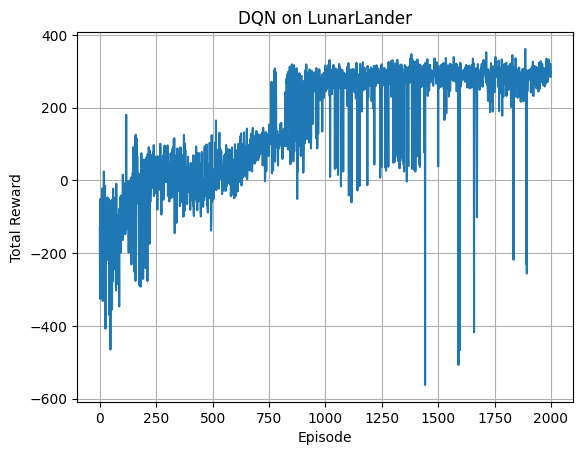

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [ ]:
config_v4 = {
    "env_name": "LunarLander-v3",
    "learning_rate": 0.0001,
    "gamma": 0.99,
    "epsilon": 1.0,
    "epsilon_min": 0.01,
    "epsilon_decay": 0.995,
    "n_episodes": 2000,
    "batch_size": 64,
    "reward_shaping_fn": balanced_shaping1
}


# Train và vẽ kết quả
agent3 = DQNAgent(config=config_v4)
train_dqn_1(agent3)
plot_rewards(agent3)
record_video(agent3,"dqn_v4_lander.mp4")

In [ ]:
# Lưu mô hình vào file .pth
torch.save(agent3.model.state_dict(), "dqn_lunarlander_v4.pth")

# Đánh giá mô hình và in ra video tệ nhất 
ani_best, ani_worst = evaluate_agent(agent3, "dqn_lunarlander_v4.pth")
ani_worst

C:\Users\ASUS\AppData\Local\Temp\ipykernel_31096\3724014575.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  agent.model.load_state_dict(torch.load(model_path))


Episode 1: Reward = 240.81
Episode 2: Reward = 258.79
Episode 3: Reward = 259.89
Episode 4: Reward = 295.83
Episode 5: Reward = 223.90
Episode 6: Reward = 273.10
Episode 7: Reward = 274.08
Episode 8: Reward = 283.81
Episode 9: Reward = 281.31
Episode 10: Reward = 263.90
Episode 11: Reward = 249.71
Episode 12: Reward = 252.14
Episode 13: Reward = 272.66
Episode 14: Reward = 253.34
Episode 15: Reward = 235.13
Episode 16: Reward = 274.47
Episode 17: Reward = 271.85
Episode 18: Reward = 265.71
Episode 19: Reward = 270.87
Episode 20: Reward = 286.10

Tỷ lệ hạ cánh thành công: 20/20 (100.0%)
Reward cao nhất: 295.83
Reward thấp nhất: 223.90

 Animation tốt nhất hiển thị bên dưới. Gọi `ani_worst_html` để xem video tệ nhất.


In [ ]:
# In ra video tốt nhất 
ani_best

# 2. Dueling DQN 

## Mạng Dueling DQN

In [3]:
class DuelingDQN(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(DuelingDQN, self).__init__()
        
        # Mạng trích xuất đặc trưng chung từ đầu vào trạng thái
        self.feature = nn.Sequential(
            nn.Linear(state_dim, 128),  # Lớp fully connected đầu vào
            nn.ReLU()                   # Kích hoạt phi tuyến
        )
        
        # Nhánh giá trị trạng thái V(s)
        self.value_stream = nn.Sequential(
            nn.Linear(128, 64),         # Lớp ẩn trung gian
            nn.ReLU(),                  # Kích hoạt phi tuyến
            nn.Linear(64, 1)            # Đầu ra chỉ 1 giá trị: V(s)
        )
        
        # Nhánh lợi thế hành động A(s, a)
        self.advantage_stream = nn.Sequential(
            nn.Linear(128, 64),         # Lớp ẩn trung gian
            nn.ReLU(),                  # Kích hoạt phi tuyến
            nn.Linear(64, action_dim)   # Đầu ra là A(s,a) cho mọi hành động
        )

    def forward(self, x):
        features = self.feature(x)  # Trích xuất đặc trưng chung từ trạng thái
        
        values = self.value_stream(features)         # Tính giá trị V(s)
        advantages = self.advantage_stream(features) # Tính lợi thế A(s,a)

        # Kết hợp V(s) và A(s,a) để tính Q(s,a) theo công thức:
        # Q(s,a) = V(s) + (A(s,a) - mean(A(s,a')))
        q = values + (advantages - advantages.mean(dim=1, keepdim=True))
        
        return q  # Trả về Q-value cho tất cả các hành động

## Replay Buffer

In [4]:
class ReplayBuffer:
    def __init__(self, capacity):
        self.buffer = deque(maxlen=capacity)  # Danh sách kinh nghiệm (state, action, reward, next_state, done)

    def push(self, state, action, reward, next_state, done):
        self.buffer.append((state, action, reward, next_state, done))  # Thêm một kinh nghiệm vào bộ nhớ

    def sample(self, batch_size):
        batch = random.sample(self.buffer, batch_size)  # Lấy mẫu minibatch ngẫu nhiên
        states, actions, rewards, next_states, dones = map(np.array, zip(*batch))  # Tách thành các mảng numpy
        return states, actions, rewards, next_states, dones

    def __len__(self):
        return len(self.buffer)  # Trả về số phần tử hiện có trong buffer


## Agent Dueling DQN 

In [5]:
class DuelingDQNAgent:
    def __init__(self, state_dim, action_dim, config):
        # Khởi tạo mô hình, mạng chính và mạng mục tiêu, bộ nhớ, và các tham số huấn luyện
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.policy_net = DuelingDQN(state_dim, action_dim).to(self.device)
        self.target_net = DuelingDQN(state_dim, action_dim).to(self.device)
        self.target_net.load_state_dict(self.policy_net.state_dict())

        self.optimizer = optim.Adam(self.policy_net.parameters(), lr=config["lr"])
        self.replay_buffer = ReplayBuffer(config["buffer_size"])
        self.gamma = config["gamma"]
        self.batch_size = config["batch_size"]
        self.epsilon = config["epsilon_start"]
        self.epsilon_min = config["epsilon_min"]
        self.epsilon_decay = config["epsilon_decay"]
        self.action_dim = action_dim
        self.update_freq = config["target_update_freq"]

        self.rewards = []

    # Chọn hành động theo epsilon-greedy (khám phá or khai thác)
    def act(self, state):
        if np.random.rand() < self.epsilon:
            return np.random.randint(self.action_dim)
        state = torch.FloatTensor(state).unsqueeze(0).to(self.device)
        with torch.no_grad():
            q_values = self.policy_net(state)
        return q_values.argmax().item()

    # Huấn luyện mạng chính từ bộ nhớ kinh nghiệm (Replay Buffer)
    def update(self):
        if len(self.replay_buffer) < self.batch_size:
            return

        states, actions, rewards, next_states, dones = self.replay_buffer.sample(self.batch_size)
        states = torch.FloatTensor(states).to(self.device)
        actions = torch.LongTensor(actions).to(self.device)
        rewards = torch.FloatTensor(rewards).to(self.device)
        next_states = torch.FloatTensor(next_states).to(self.device)
        dones = torch.FloatTensor(dones).to(self.device)

        q_values = self.policy_net(states).gather(1, actions.unsqueeze(1)).squeeze(1)
        with torch.no_grad():
            max_next_q = self.target_net(next_states).max(1)[0]
            target_q = rewards + self.gamma * max_next_q * (1 - dones)

        loss = nn.MSELoss()(q_values, target_q)
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

    # Đồng bộ hóa mạng mục tiêu với mạng chính
    def update_target_network(self):
        self.target_net.load_state_dict(self.policy_net.state_dict())

    # Giảm epsilon theo hàm mũ để giảm dần hành vi ngẫu nhiên
    def decay_epsilon(self):
        self.epsilon = max(self.epsilon_min, self.epsilon * self.epsilon_decay)


## Huấn luyện 

In [6]:
def train_dueling_dqn(config):
    env = gym.make("LunarLander-v3")
    state_dim = env.observation_space.shape[0]
    action_dim = env.action_space.n

    agent = DuelingDQNAgent(state_dim, action_dim, config)

    for episode in range(config["n_episodes"]):
        state, _ = env.reset()
        total_reward = 0
        done = False

        while not done:
            action = agent.act(state)
            next_state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            agent.replay_buffer.push(state, action, reward, next_state, done)
            state = next_state
            total_reward += reward

            agent.update()

        agent.decay_epsilon()

        if (episode + 1) % agent.update_freq == 0:
            agent.update_target_network()

        agent.rewards.append(total_reward)

        if (episode + 1) % 10 == 0:
            print(f"Episode {episode+1}, Reward: {total_reward:.2f}, Epsilon: {agent.epsilon:.3f}")

    env.close()
    return agent

## Vẽ biểu đồ reward

In [7]:
def plot_rewards_ddqn(agent):
    plt.plot(agent.rewards)
    plt.xlabel("Episode")
    plt.ylabel("Total Reward")
    plt.title("Dueling DQN on LunarLander")
    plt.grid(True)
    plt.show()

##  Ghi video agent hoạt động

In [8]:
def record_video_ddqn(agent, filename):
    env = gym.make("LunarLander-v3", render_mode="rgb_array")
    state, _ = env.reset()
    frames = []
    done = False

    while not done:
        frame = env.render()
        frames.append(frame)
        action = agent.act(state)
        state, _, terminated, truncated, _ = env.step(action)
        done = terminated or truncated

    env.close() 
    imageio.mimsave(filename, [np.array(f) for f in frames], fps=30)


## Đánh giá mô hình 

In [9]:
# Hàm đánh giá trên 20 tập 
def evaluate_agent_ddqn(agent, model_path, env_name="LunarLander-v3", n_episodes=20):
    agent.policy_net.load_state_dict(torch.load(model_path))
    agent.policy_net.eval()

    original_epsilon = agent.epsilon
    agent.epsilon = 0.0

    env = gym.make(env_name, render_mode="rgb_array")
    best_reward = -float('inf')
    worst_reward = float('inf')
    best_frames = []
    worst_frames = []
    success_count = 0

    for ep in range(n_episodes):
        state, _ = env.reset()
        done = False
        total_reward = 0
        frames = []

        while not done:
            frame = env.render()
            frames.append(frame)

            action = agent.act(state)
            state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated
            total_reward += reward

        if reward == 100:
            success_count += 1

        if total_reward > best_reward:
            best_reward = total_reward
            best_frames = frames

        if total_reward < worst_reward:
            worst_reward = total_reward
            worst_frames = frames

        print(f"Episode {ep+1}: Reward = {total_reward:.2f}")

    env.close()
    agent.epsilon = original_epsilon

    success_rate = success_count / n_episodes * 100
    print(f"\nTỷ lệ hạ cánh thành công: {success_count}/{n_episodes} ({success_rate:.1f}%)")
    print(f"Reward cao nhất: {best_reward:.2f}")
    print(f"Reward thấp nhất: {worst_reward:.2f}")

    # Tạo animation: best 
    fig_best = plt.figure(figsize=(6, 6))
    img_best = plt.imshow(best_frames[0])

    def animate_best(i):
        img_best.set_array(best_frames[i])
        return [img_best]

    ani_best = animation.FuncAnimation(fig_best, animate_best, frames=len(best_frames), interval=33)
    plt.close(fig_best)

    # Tạo animation: worst
    fig_worst = plt.figure(figsize=(6, 6))
    img_worst = plt.imshow(worst_frames[0])

    def animate_worst(i):
        img_worst.set_array(worst_frames[i])
        return [img_worst]

    ani_worst = animation.FuncAnimation(fig_worst, animate_worst, frames=len(worst_frames), interval=33)
    plt.close(fig_worst)

    print("Hiển thị animation tốt nhất trước. Gọi biến `ani_worst_html` để xem video tệ nhất.")

    ani_best_html = HTML(ani_best.to_jshtml())
    ani_worst_html = HTML(ani_worst.to_jshtml())

    return ani_best_html, ani_worst_html


In [ ]:
def train_dueling_dqn_2(config):
    env = gym.make("LunarLander-v3")
    state_dim = env.observation_space.shape[0]
    action_dim = env.action_space.n

    agent = DuelingDQNAgent(state_dim, action_dim, config)

    for episode in range(config["n_episodes"]):
        state, _ = env.reset()
        total_reward = 0
        done = False

        while not done:
            action = agent.act(state)
            next_state, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated

            shaping_bonus = 0.0
            x = next_state[0]
            y = next_state[1]
            angle = next_state[4]
            leg1 = next_state[6]
            leg2 = next_state[7]

            if abs(angle) < 0.1 and abs(x) < 0.2:
                shaping_bonus += 0.1

            if y < 0.7:
                shaping_bonus += 0.03

            if leg1 == 1.0 and leg2 == 1.0 and action in [1, 2, 3]: # Thêm phần phạt động cơ 
                shaping_bonus -= 3.0 

            if done and reward == 100:
                if abs(x) < 0.2 and abs(angle) < 0.1:
                    shaping_bonus += 5.0
                else:
                    shaping_bonus += 1.0

            shaped_reward = reward + shaping_bonus
            agent.replay_buffer.push(state, action, shaped_reward, next_state, done)

            state = next_state
            total_reward += reward

            agent.update()

        agent.decay_epsilon()

        if (episode + 1) % agent.update_freq == 0:
            agent.update_target_network()

        agent.rewards.append(total_reward)

        if (episode + 1) % 10 == 0:
            print(f"Episode {episode+1}, Reward: {total_reward:.2f}, Epsilon: {agent.epsilon:.3f}")

    env.close()
    return agent

Episode 10, Reward: -63.25, Epsilon: 0.951
Episode 20, Reward: -80.57, Epsilon: 0.905
Episode 30, Reward: -132.05, Epsilon: 0.860
Episode 40, Reward: -111.14, Epsilon: 0.818
Episode 50, Reward: -137.73, Epsilon: 0.778
Episode 60, Reward: -34.32, Epsilon: 0.740
Episode 70, Reward: -62.61, Epsilon: 0.704
Episode 80, Reward: -309.84, Epsilon: 0.670
Episode 90, Reward: -186.95, Epsilon: 0.637
Episode 100, Reward: -153.34, Epsilon: 0.606
Episode 110, Reward: -256.97, Epsilon: 0.576
Episode 120, Reward: -36.22, Epsilon: 0.548
Episode 130, Reward: -36.82, Epsilon: 0.521
Episode 140, Reward: -217.37, Epsilon: 0.496
Episode 150, Reward: -16.97, Epsilon: 0.471
Episode 160, Reward: -84.04, Epsilon: 0.448
Episode 170, Reward: 60.28, Epsilon: 0.427
Episode 180, Reward: 126.37, Epsilon: 0.406
Episode 190, Reward: 36.18, Epsilon: 0.386
Episode 200, Reward: 82.98, Epsilon: 0.367
Episode 210, Reward: -52.17, Epsilon: 0.349
Episode 220, Reward: -62.38, Epsilon: 0.332
Episode 230, Reward: 43.00, Epsilon:

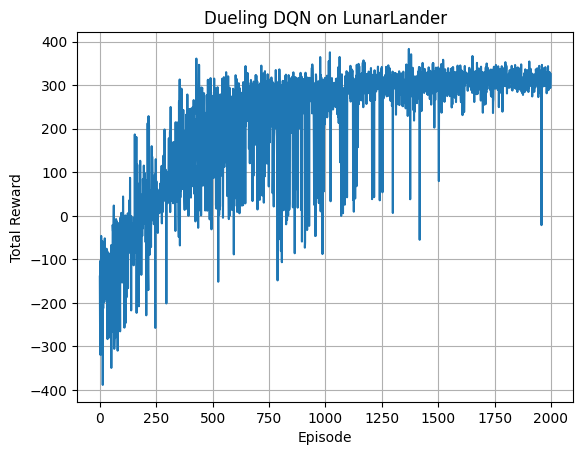

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (600, 400) to (608, 400) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


In [ ]:
config_v6 = {
    "lr": 0.0001,
    "gamma": 0.99,
    "epsilon_start": 1.0,
    "epsilon_min": 0.01,
    "epsilon_decay": 0.995,
    "batch_size": 128,
    "buffer_size": 100000,
    "n_episodes": 2000,
    "target_update_freq": 10
}

agent_v6 = train_dueling_dqn_2(config_v6)
plot_rewards_ddqn(agent_v6)
record_video_ddqn(agent_v6,"dueling_dqn_v6_lander.mp4")

In [ ]:
# Lưu mô hình vào file .pth
torch.save(agent_v6.policy_net.state_dict(), "dueling_dqn_lander_v6.pth")

# Đánh giá mô hình và in ra video tệ nhất 
ani_best, ani_worst = evaluate_agent_ddqn(agent_v6, "dueling_dqn_lander_v6.pth")
ani_worst

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14144\2977220452.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  agent.policy_net.load_state_dict(torch.load(model_path))


Episode 1: Reward = 302.80
Episode 2: Reward = 287.54
Episode 3: Reward = 293.60
Episode 4: Reward = 287.83
Episode 5: Reward = 250.84
Episode 6: Reward = 289.45
Episode 7: Reward = 281.36
Episode 8: Reward = 282.52
Episode 9: Reward = 257.55
Episode 10: Reward = 258.57
Episode 11: Reward = 298.95
Episode 12: Reward = 285.13
Episode 13: Reward = 257.71
Episode 14: Reward = 255.41
Episode 15: Reward = 281.48
Episode 16: Reward = 270.41
Episode 17: Reward = 258.41
Episode 18: Reward = 305.26
Episode 19: Reward = 319.09
Episode 20: Reward = 301.35

Tỷ lệ hạ cánh thành công: 20/20 (100.0%)
Reward cao nhất: 319.09
Reward thấp nhất: 250.84
Hiển thị animation tốt nhất trước. Gọi biến `ani_worst_html` để xem video tệ nhất.


In [ ]:
ani_best